<a href="https://colab.research.google.com/github/nasif-raihan/ML-and-DL-Codes/blob/main/2D_Pose_Estimation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



*   [Resource Followed for Image](https://www.analyticsvidhya.com/blog/2022/03/pose-detection-in-image-using-mediapipe-library/)
*   [Resource Followed for Video](https://www.analyticsvidhya.com/blog/2021/05/pose-estimation-using-opencv/)



In [ ]:
import time
import cv2 as cv
from matplotlib import pyplot as plt

In [ ]:
!pip install -q mediapipe
import mediapipe as mp

# Image

In [ ]:
!gdown -q 1c7moh7H2_v-mnWzvs23-ynAaMp3qXM6U # image

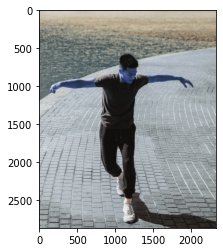

In [ ]:
img = cv.imread('/content/raw-image.png')
plt.imshow(img)
plt.show()

In [ ]:
# Initialize mediapipe pose class.
mp_pose = mp.solutions.pose

# Setup the Pose function for images - independently for the images standalone processing.
pose_image = mp_pose.Pose(static_image_mode=True, min_detection_confidence=0.5)

# Setup the Pose function for videos - for video processing.
pose_video = mp_pose.Pose(static_image_mode=False, min_detection_confidence=0.7,
                          min_tracking_confidence=0.7)

# Initialize mediapipe drawing class - to draw the landmarks points.
mp_drawing = mp.solutions.drawing_utils

In [ ]:
def detectPose(image_pose, pose, draw=False, display=False):

  original_image = image_pose.copy()  # copy!
  
  image_in_RGB = cv.cvtColor(image_pose, cv.COLOR_BGR2RGB)
  
  resultant = pose.process(image_in_RGB)

  if resultant.pose_landmarks and draw:    

      mp_drawing.draw_landmarks(image=original_image, landmark_list=resultant.pose_landmarks,
                                connections=mp_pose.POSE_CONNECTIONS,
                                landmark_drawing_spec=mp_drawing.DrawingSpec(color=(255,255,255),
                                                                              thickness=3, circle_radius=3),
                                connection_drawing_spec=mp_drawing.DrawingSpec(color=(49,125,237),
                                                                              thickness=2, circle_radius=2))

  if display:
    plt.figure(figsize=[22,22])
    plt.subplot(121);plt.imshow(image_pose[:,:,::-1]);plt.title("Input Image");plt.axis('off');
    plt.subplot(122);plt.imshow(original_image[:,:,::-1]);plt.title("Pose detected Image");plt.axis('off');
    cv.imwrite('rendered-image.png', img)
    
  else:
    return original_image, results

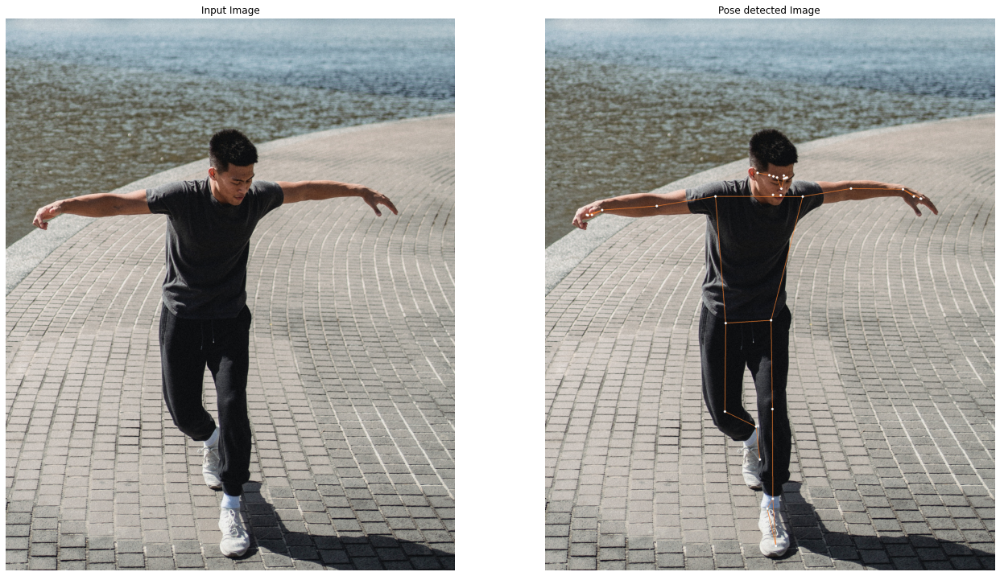

In [ ]:
# Here we will read our image from the specified path to detect the pose
output = img
detectPose(output, pose_image, draw=True, display=True)

# Video

In [ ]:
!gdown -q 1tR_Yi9Ye1PzalMDevsYmMuEvMCKkSXHc # video

In [ ]:
pose = mp_pose.Pose()

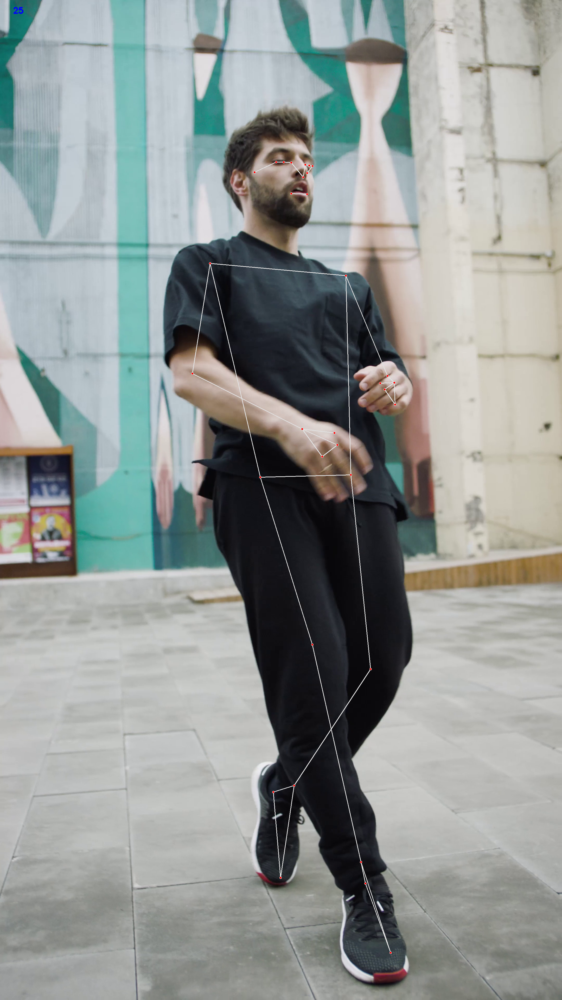

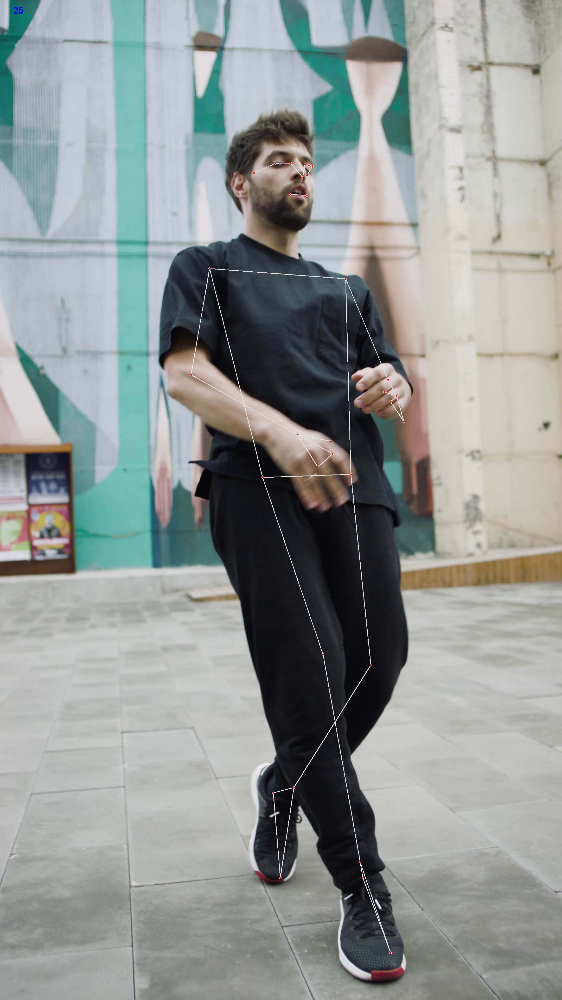

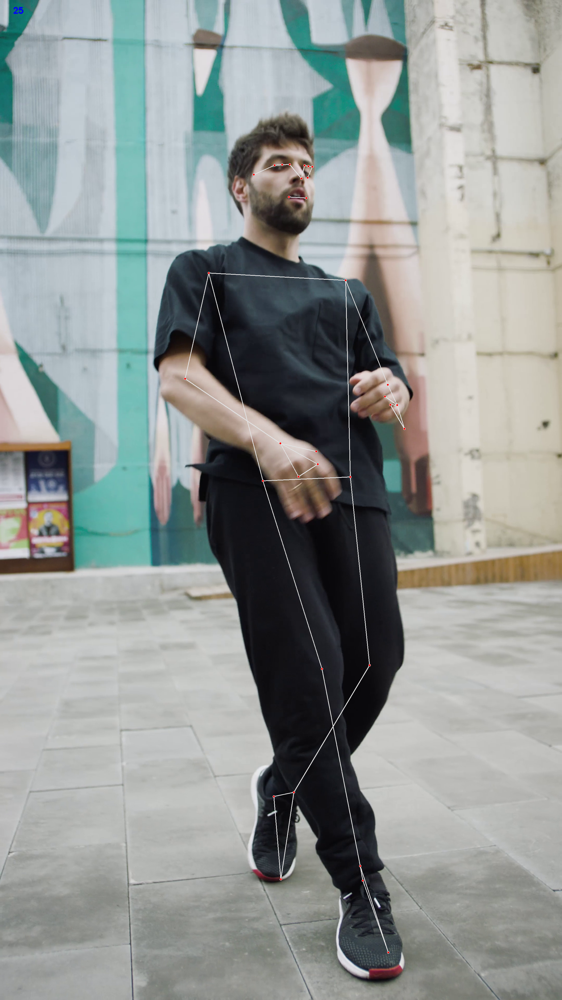

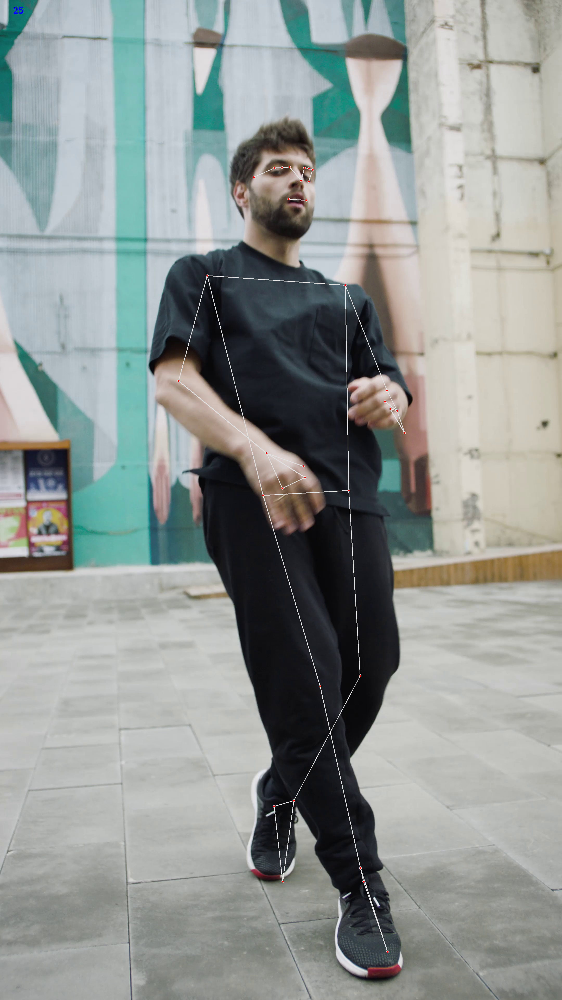

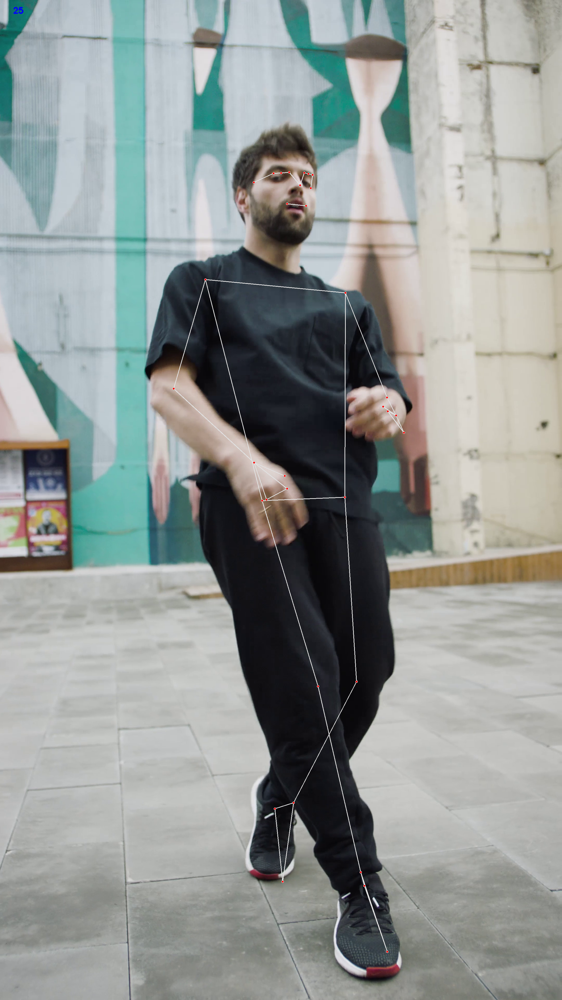

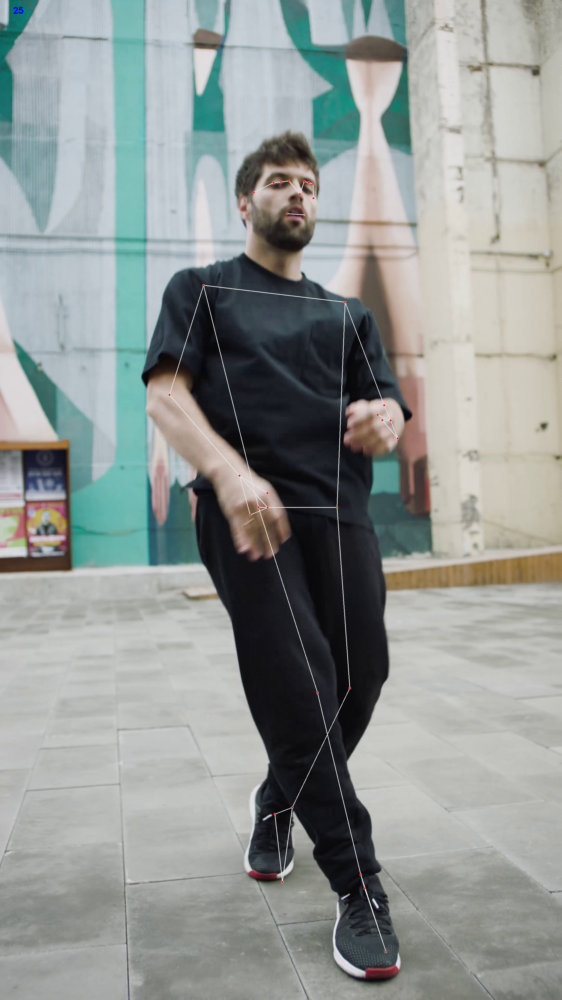

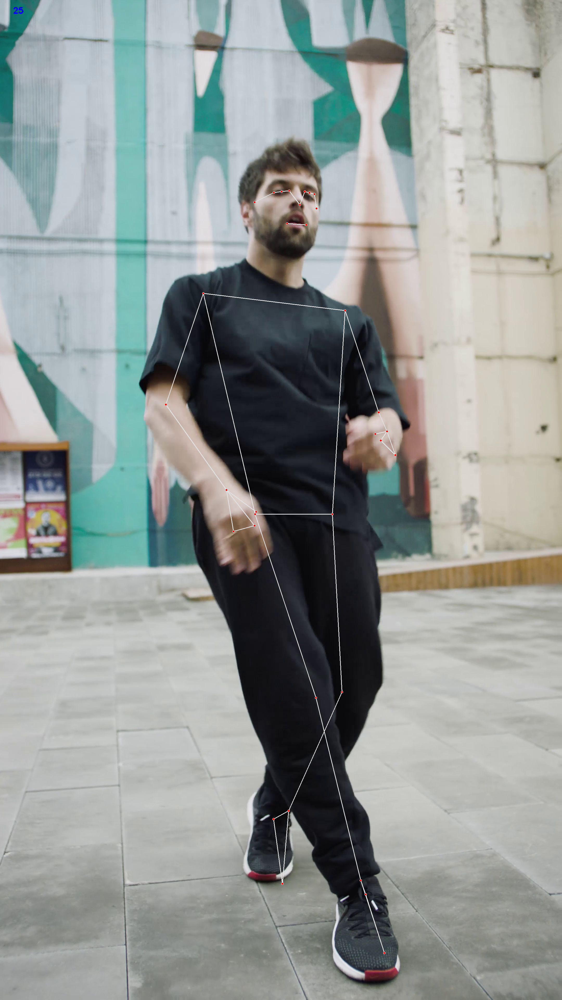

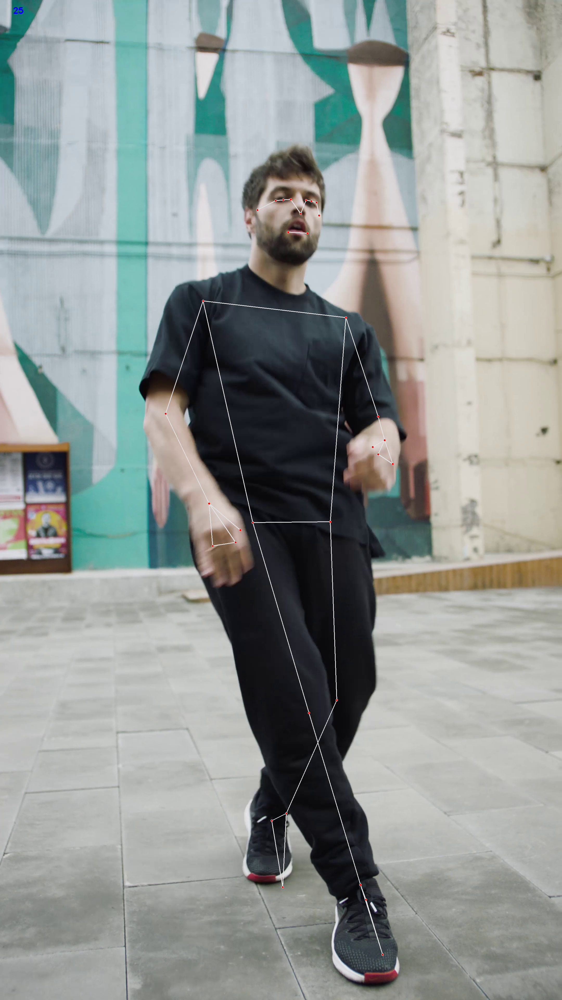

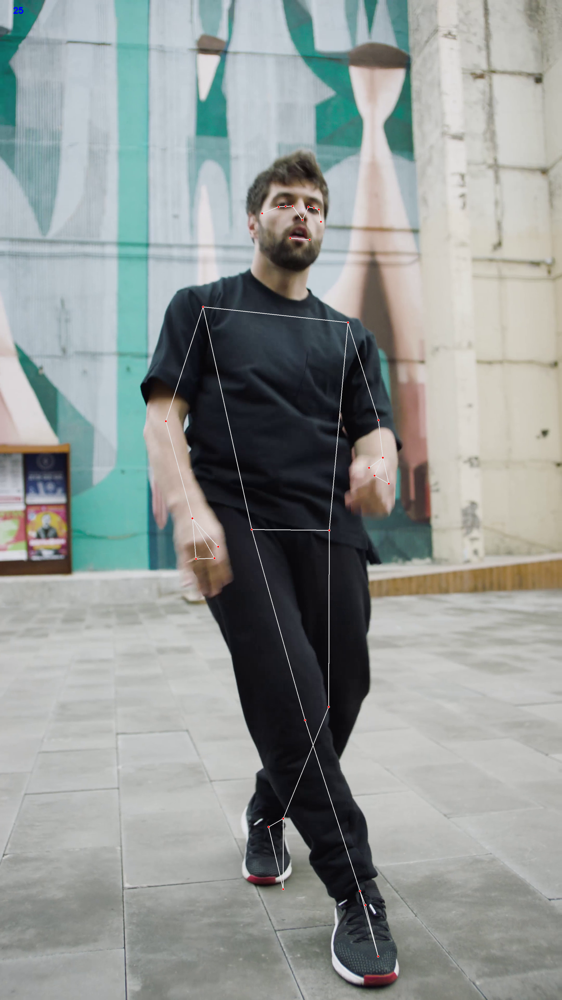

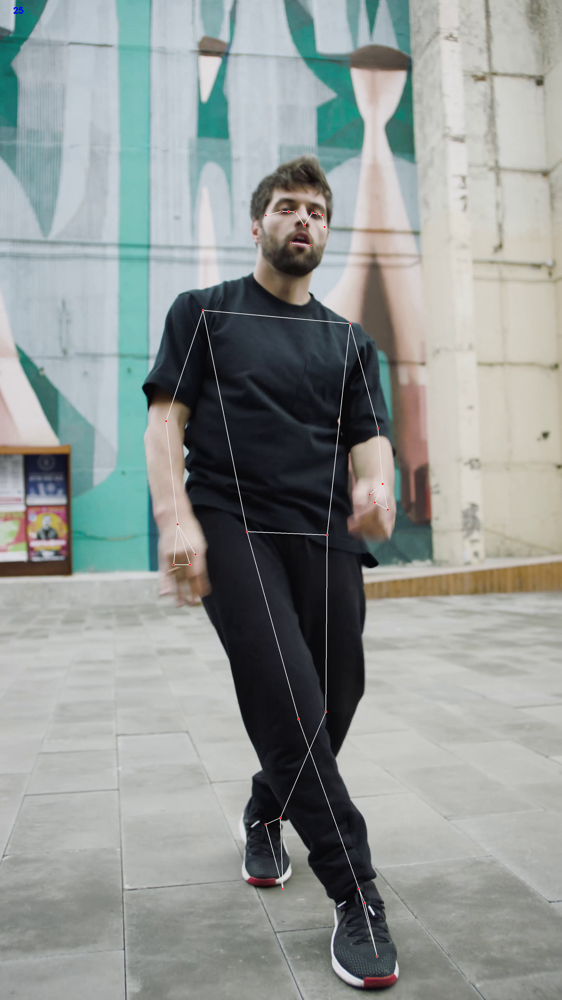

In [ ]:
# cap = cv2.VideoCapture(0)

from google.colab.patches import cv2_imshow

cap = cv.VideoCapture('/content/raw-video.mp4')
fps = cap.get((cv.CAP_PROP_FPS))

frame_list = []

success, img = cap.read()
while success:
  success, img = cap.read()

  imgRGB = cv.cvtColor(img, cv.COLOR_BGR2RGB)
  results = pose.process(imgRGB)
  # print(results.pose_landmarks)

  if results.pose_landmarks:
    mp_drawing.draw_landmarks(img, results.pose_landmarks, mp_pose.POSE_CONNECTIONS)

  cv.putText(img, str(int(fps)), (50,50), cv.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 3)
  cv2_imshow(img)

  frame_list.append(img)

  cv.waitKey(1)

In [ ]:
print(len(frame_list))

In [ ]:
w, h, c = frame_list[0].shape
video = cv.VideoWriter("/content/rendered-video.mp4", cv.VideoWriter_fourcc('m','p','4','v'), fps, (h, w))

for i in range(len(frame_list)):
    video.write(frame_list[i])

video.release()